# Generative Adversarial Network
## Credit to: https://heartbeat.fritz.ai/introduction-to-generative-adversarial-networks-gans-35ef44f21193

In [1]:
import keras
import matplotlib.pyplot as plt
from keras.layers import Input
from keras.models import Model, Sequential
from keras.layers.core import Dense, Dropout
from keras.layers.advanced_activations import LeakyReLU
from keras.datasets import mnist
from keras.optimizers import Adam
from keras import initializers
from tqdm import tqdm

Using TensorFlow backend.


In [2]:
import numpy as np
np.random.seed(1000)
#Next we set the dimension of a random noise vector.
random_dim = 100

In [3]:
def load_minst_data():
  (x_train, y_train), (x_test, y_test) = mnist.load_data()
  x_train = x_train.reshape(-1, 784) / 255
  x_test = x_test.reshape(-1, 784) / 255
  return (x_train, y_train, x_test, y_test)

x_train, y_train, x_test, y_test = load_minst_data()

In [4]:
print(x_train.shape,x_test.shape)

(60000, 784) (10000, 784)


In [5]:
optimizer = Adam(lr=0.0002, beta_1=0.5)

In [6]:
generator = Sequential()
generator.add(Dense(256, input_dim=random_dim, kernel_initializer=initializers.RandomNormal(stddev=0.02)))
generator.add(LeakyReLU(0.2))
generator.add(Dense(512))
generator.add(LeakyReLU(0.2))
generator.add(Dense(1024))
generator.add(LeakyReLU(0.2))
generator.add(Dense(784, activation='tanh'))
generator.compile(loss='binary_crossentropy', optimizer=optimizer)

In [7]:
discriminator = Sequential()
discriminator.add(Dense(1024, input_dim=784, kernel_initializer=initializers.RandomNormal(stddev=0.02)))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.3))
discriminator.add(Dense(512))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.3))
discriminator.add(Dense(256))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.3))
discriminator.add(Dense(1, activation='sigmoid'))
discriminator.compile(loss='binary_crossentropy', optimizer=optimizer)

In [8]:
discriminator.trainable = False
ganInput = Input(shape=(random_dim,))

In [9]:
x = generator(ganInput)
ganOutput = discriminator(x)
gan = Model(inputs=ganInput, outputs=ganOutput)
gan.compile(loss='binary_crossentropy', optimizer=optimizer)

In [10]:
20%10

0

In [11]:
def plot_generated_images(epoch, generator, examples=100, dim=(10, 10), figsize=(10, 10)):
  noise = np.random.normal(0, 1, size=[examples, random_dim])
  generated_images = generator.predict(noise)
  generated_images = generated_images.reshape(examples, 28, 28)
  plt.figure(figsize=figsize)
  for i in range(generated_images.shape[0]):
    plt.subplot(dim[0], dim[1], i+1)
    plt.imshow(generated_images[i], interpolation='nearest', cmap='gray_r')
    plt.axis('off')
  plt.tight_layout()
  
  if epoch in [1,20,40,60,80,100]:
    plt.savefig('image_generated_%d.png' % epoch)

In [12]:
def train(epochs=1, batch_size=128):
  x_train, y_train, x_test, y_test = load_minst_data()
  batch_count = x_train.shape[0] / batch_size
  for e in range(1, epochs+1):
    print('-'*10, 'Epoch %d' % e, '-'*10)
    for _ in tqdm(range(int(batch_count))):
        
      noise = np.random.normal(0, 1, size=[batch_size, random_dim])
      image_batch = x_train[np.random.randint(0, x_train.shape[0], size=batch_size)]
      generated_images = generator.predict(noise)
      X = np.concatenate([image_batch, generated_images])
      y_dis = np.zeros(2*batch_size)
      y_dis[:batch_size] = 0.9
      discriminator.trainable = True
      discriminator.train_on_batch(X, y_dis)
        
      noise = np.random.normal(0, 1, size=[batch_size, random_dim])
      y_gen = np.ones(batch_size)
      discriminator.trainable = False
      gan.train_on_batch(noise, y_gen)
                            
    plot_generated_images(e, generator)

---------- Epoch 1 ----------


100%|███████████████████████████████████| 468/468 [00:17<00:00, 27.02it/s]


---------- Epoch 2 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.89it/s]


---------- Epoch 3 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.63it/s]


---------- Epoch 4 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 42.11it/s]


---------- Epoch 5 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.33it/s]


---------- Epoch 6 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 42.16it/s]


---------- Epoch 7 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.39it/s]


---------- Epoch 8 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.23it/s]


---------- Epoch 9 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.98it/s]


---------- Epoch 10 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 42.14it/s]


---------- Epoch 11 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.97it/s]


---------- Epoch 12 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.86it/s]


---------- Epoch 13 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 42.10it/s]


---------- Epoch 14 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 39.09it/s]


---------- Epoch 15 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.85it/s]


---------- Epoch 16 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.13it/s]


---------- Epoch 17 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.57it/s]


---------- Epoch 18 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.46it/s]


---------- Epoch 19 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 42.09it/s]


---------- Epoch 20 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.45it/s]


---------- Epoch 21 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.52it/s]
c:\users\leo\appdata\local\programs\python\python36\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


---------- Epoch 22 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.70it/s]


---------- Epoch 23 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.54it/s]


---------- Epoch 24 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.29it/s]


---------- Epoch 25 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.41it/s]


---------- Epoch 26 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.88it/s]


---------- Epoch 27 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.65it/s]


---------- Epoch 28 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.81it/s]


---------- Epoch 29 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.26it/s]


---------- Epoch 30 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.64it/s]


---------- Epoch 31 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.53it/s]


---------- Epoch 32 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.52it/s]


---------- Epoch 33 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.67it/s]


---------- Epoch 34 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.92it/s]


---------- Epoch 35 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.81it/s]


---------- Epoch 36 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.61it/s]


---------- Epoch 37 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.76it/s]


---------- Epoch 38 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.59it/s]


---------- Epoch 39 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.80it/s]


---------- Epoch 40 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.60it/s]


---------- Epoch 41 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.29it/s]


---------- Epoch 42 ----------


100%|███████████████████████████████████| 468/468 [00:12<00:00, 36.81it/s]


---------- Epoch 43 ----------


100%|███████████████████████████████████| 468/468 [00:13<00:00, 35.90it/s]


---------- Epoch 44 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 39.54it/s]


---------- Epoch 45 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.30it/s]


---------- Epoch 46 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.50it/s]


---------- Epoch 47 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.31it/s]


---------- Epoch 48 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.47it/s]


---------- Epoch 49 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.53it/s]


---------- Epoch 50 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.58it/s]


---------- Epoch 51 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.44it/s]


---------- Epoch 52 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 39.36it/s]


---------- Epoch 53 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.33it/s]


---------- Epoch 54 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.21it/s]


---------- Epoch 55 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.43it/s]


---------- Epoch 56 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.51it/s]


---------- Epoch 57 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.41it/s]


---------- Epoch 58 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.70it/s]


---------- Epoch 59 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.63it/s]


---------- Epoch 60 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.63it/s]


---------- Epoch 61 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.46it/s]


---------- Epoch 62 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.47it/s]


---------- Epoch 63 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.48it/s]


---------- Epoch 64 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.40it/s]


---------- Epoch 65 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.38it/s]


---------- Epoch 66 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.50it/s]


---------- Epoch 67 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.67it/s]


---------- Epoch 68 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.48it/s]


---------- Epoch 69 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.31it/s]


---------- Epoch 70 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.40it/s]


---------- Epoch 71 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 39.68it/s]


---------- Epoch 72 ----------


100%|███████████████████████████████████| 468/468 [00:12<00:00, 38.86it/s]


---------- Epoch 73 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 40.02it/s]


---------- Epoch 74 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 39.52it/s]


---------- Epoch 75 ----------


100%|███████████████████████████████████| 468/468 [00:12<00:00, 38.77it/s]


---------- Epoch 76 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.50it/s]


---------- Epoch 77 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.76it/s]


---------- Epoch 78 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.86it/s]


---------- Epoch 79 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.84it/s]


---------- Epoch 80 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.85it/s]


---------- Epoch 81 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.72it/s]


---------- Epoch 82 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.77it/s]


---------- Epoch 83 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.81it/s]


---------- Epoch 84 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.75it/s]


---------- Epoch 85 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.61it/s]


---------- Epoch 86 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.79it/s]


---------- Epoch 87 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.48it/s]


---------- Epoch 88 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.51it/s]


---------- Epoch 89 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.53it/s]


---------- Epoch 90 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.75it/s]


---------- Epoch 91 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.58it/s]


---------- Epoch 92 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.70it/s]


---------- Epoch 93 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.40it/s]


---------- Epoch 94 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.54it/s]


---------- Epoch 95 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.71it/s]


---------- Epoch 96 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.59it/s]


---------- Epoch 97 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.70it/s]


---------- Epoch 98 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.89it/s]


---------- Epoch 99 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.66it/s]


---------- Epoch 100 ----------


100%|███████████████████████████████████| 468/468 [00:11<00:00, 41.85it/s]


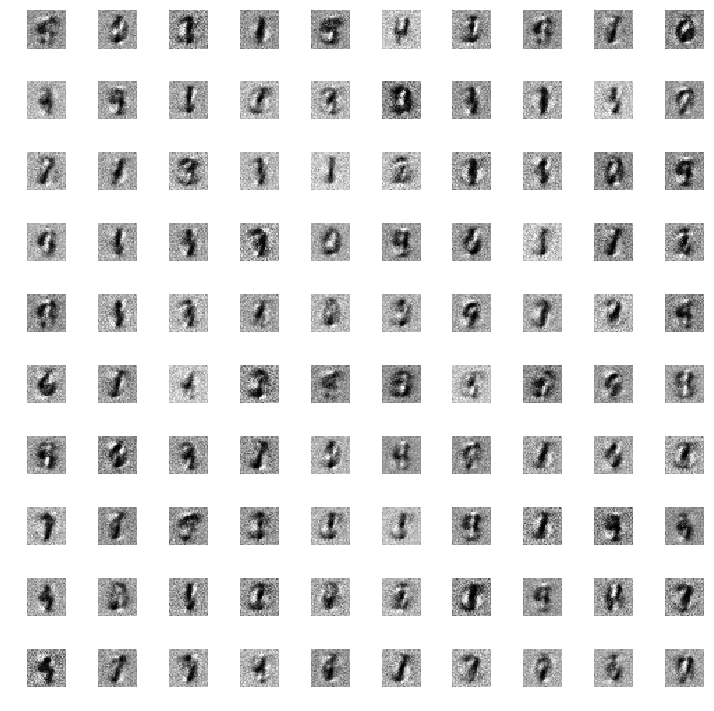

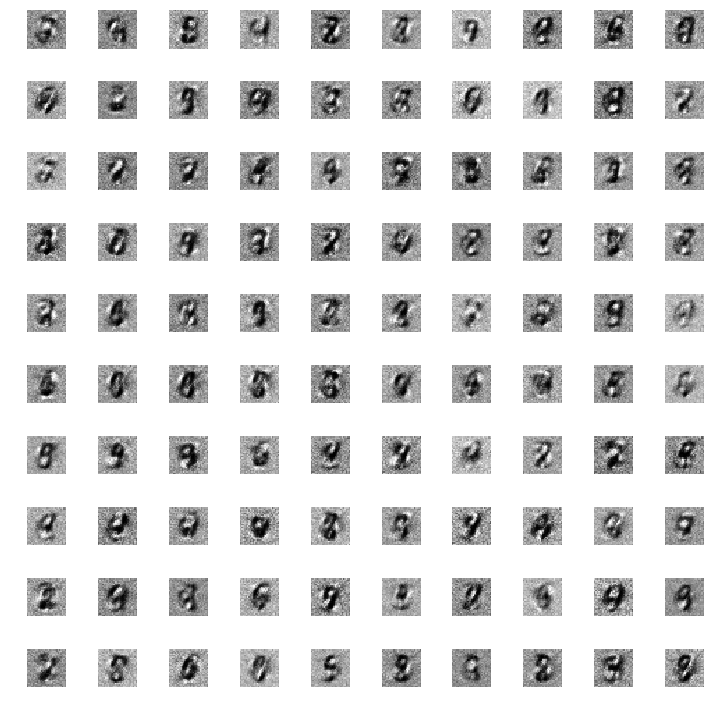

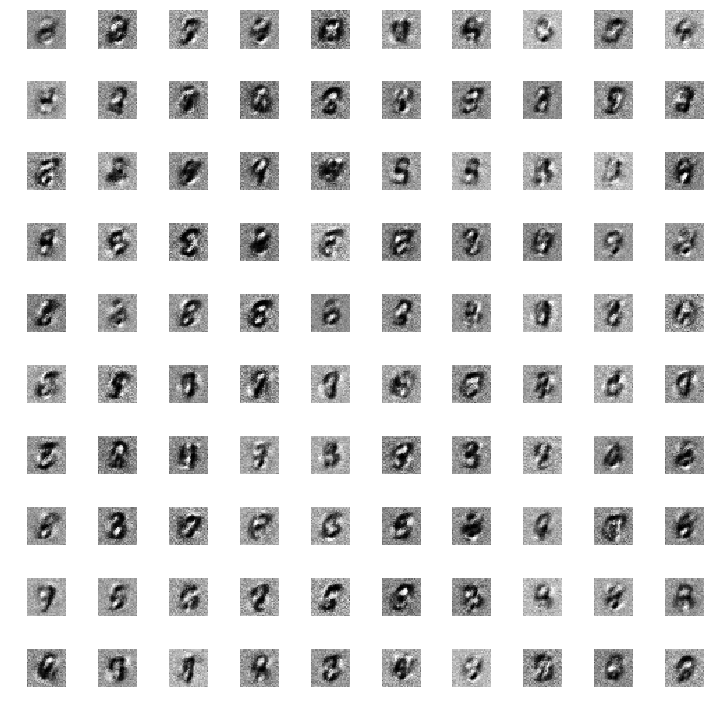

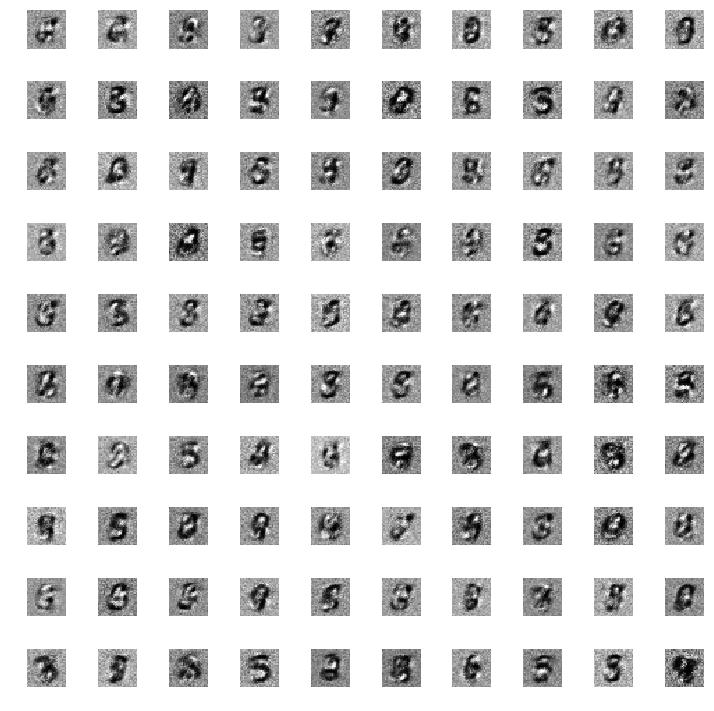

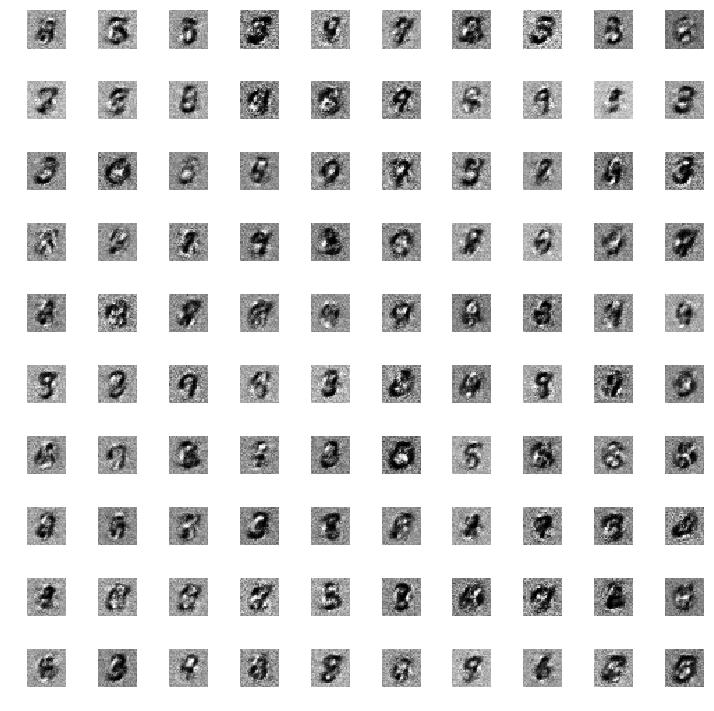

...

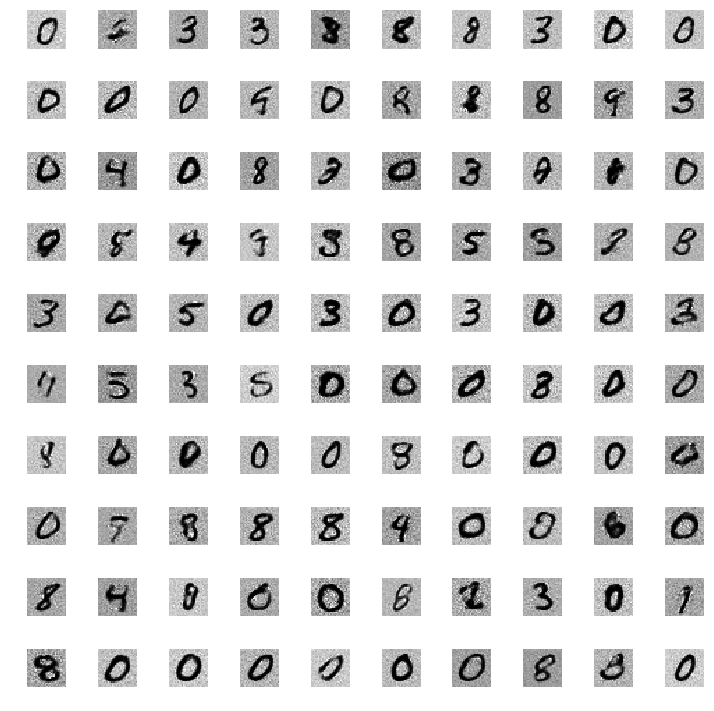

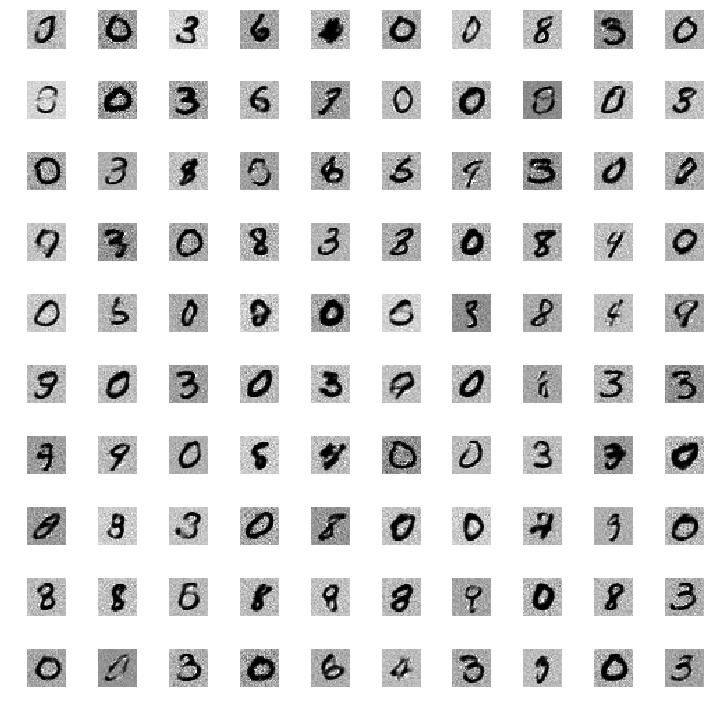

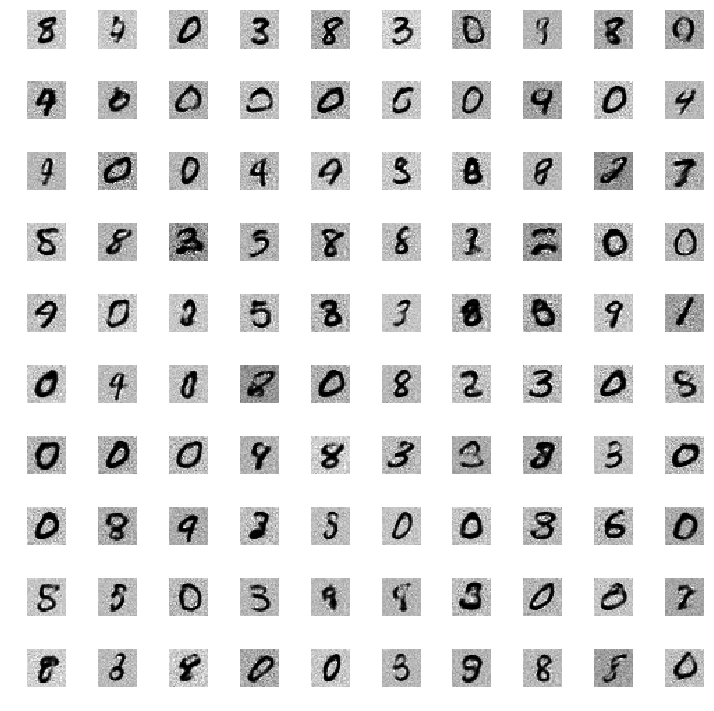

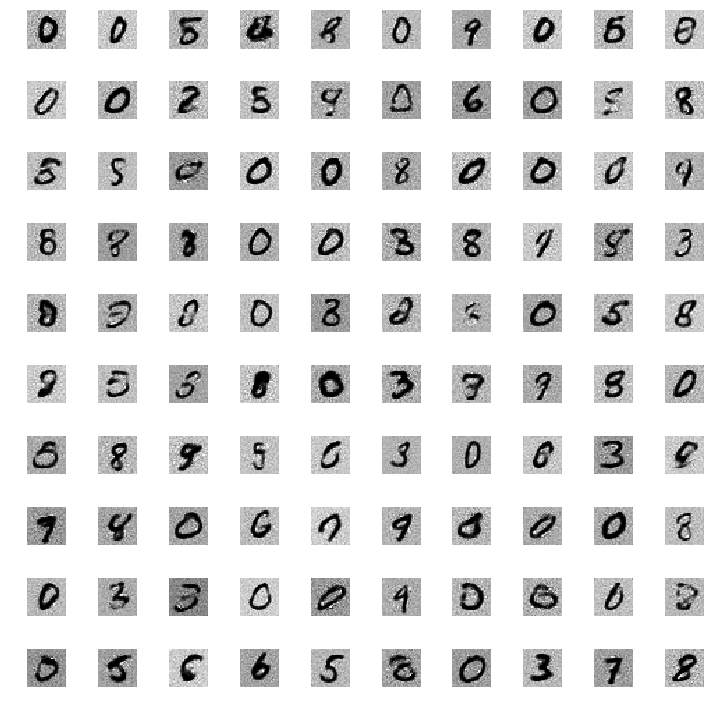

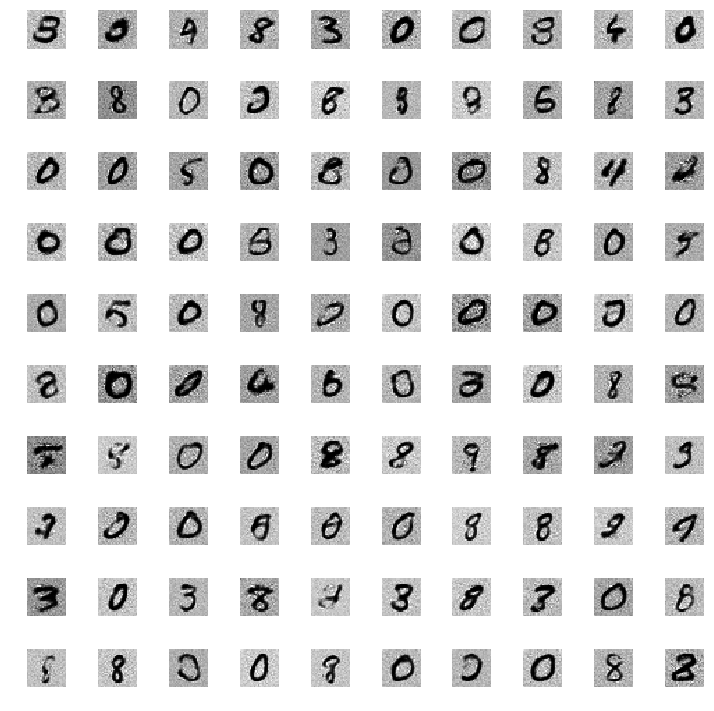

In [13]:
train(100, 128)